In [61]:
path='data/test/'
configuration = MergeConfiguration.parse_obj(
    {
        'in_collections': [
            {
                'type': 'hdf5',
                'data_path': path+'Cascade100.h5',
                'read_only':'False',
            },
            {
                'type': 'hdf5',
                'data_path': path+'Electrical100.h5',
                'read_only':'False',
            },
            {
                'type': 'hdf5',
                'data_path': path+'BioLumi100.h5',
                'read_only':'False',
            },
        ],
        'out_collection': {
                'type': 'hdf5',
                'data_path': path+'1.h5',
                'read_only':'False',
        },
        'content': [
            {
                'primary_type': RecordType.CASCADE.value,
                'secondary_types': [RecordType.ELECTRICAL.value],
                'number_of_records': 10,
                'interval': {
                    'start': 0,
                    'end': 1000,
                }
            },
           
        ]
    }
)

print(configuration)

in_collections=[HDF5StorageConfiguration(type=<StorageTypes.HDF5: 'hdf5'>, read_only=False, batch_size=100, data_path='data/test/Cascade100.h5', complevel=3, complib='lzo', optlevel=6), HDF5StorageConfiguration(type=<StorageTypes.HDF5: 'hdf5'>, read_only=False, batch_size=100, data_path='data/test/Electrical100.h5', complevel=3, complib='lzo', optlevel=6), HDF5StorageConfiguration(type=<StorageTypes.HDF5: 'hdf5'>, read_only=False, batch_size=100, data_path='data/test/BioLumi100.h5', complevel=3, complib='lzo', optlevel=6)] tmp_collection=HDF5StorageConfiguration(type=<StorageTypes.HDF5: 'hdf5'>, read_only=False, batch_size=100, data_path='/u/arego/.local/lib/python3.10/site-packages/ananke/configurations/../../_tmp_a9811c5e-1742-4be7-8514-d157ee36bcd7data.h5', complevel=3, complib='lzo', optlevel=6) out_collection=HDF5StorageConfiguration(type=<StorageTypes.HDF5: 'hdf5'>, read_only=False, batch_size=100, data_path='data/test/1.h5', complevel=3, complib='lzo', optlevel=6) content=[Merge

In [62]:
collection=Collection.from_merge(configuration)

INFO:root:Starting to merge collections with config.
INFO:root:Starting to create joined temporary collection.
100%|██████████| 100/100 [02:09<00:00,  1.30s/it]
INFO:Collection:Starting to append collection.
100%|██████████| 100/100 [00:00<00:00, 303.28it/s]
INFO:Collection:Finished to append collection.
INFO:Collection:Starting to append collection.
100%|██████████| 100/100 [00:00<00:00, 177.42it/s]
INFO:Collection:Finished to append collection.
INFO:root:Finished creating joined temporary collection.
INFO:root:Starting to create 10 RecordType.CASCADE records
INFO:root:Secondary types: 20
100%|██████████| 10/10 [00:13<00:00,  1.35s/it]
INFO:root:Finished to create 10 RecordType.CASCADE records
INFO:root:Finished to merge collections with config.


In [41]:
collection.open()
hits=collection.storage.get_hits()
records=collection.storage.get_records()
sources=collection.storage.get_sources()
detector=collection.storage.get_detector()
collection.close()

/u/arego/.local/lib/python3.10/site-packages/ananke/visualisation/detector.py:81: PerformanceWarning:

indexing past lexsort depth may impact performance.



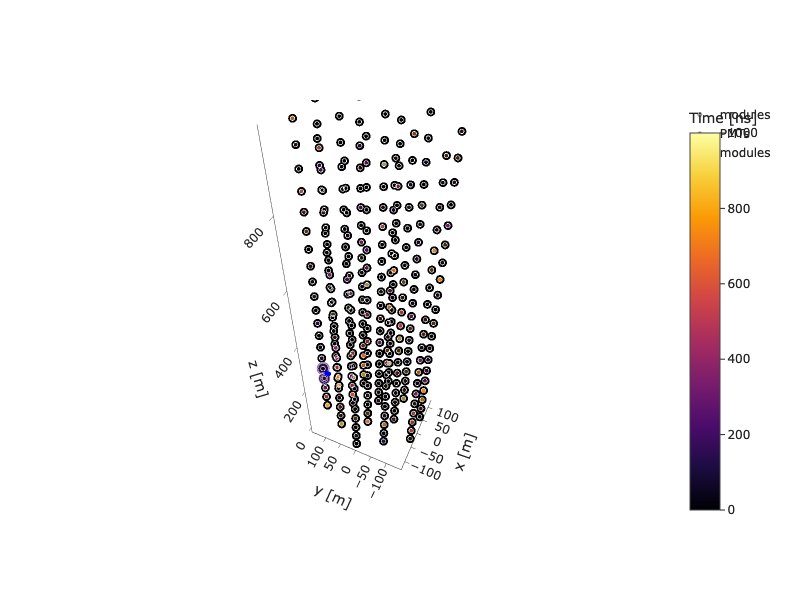

In [42]:
fig = get_detector_scatter3ds(
        detector,
        include_modules=True,
        include_pmts=True,
        hits=hits.get_by_record_ids(124),
        sources=sources.get_by_record_ids(124)
    )
fig.show()

In [44]:
for i in records.df['record_id']:
    x=hits.get_by_record_ids(i).get_statistics()
    t=x.max-x.min
    print(i,x)
    print((x.count/t))

124 count=181771 min=0.25 max=1221.0570981309836
148.89412117466023
117 count=59907 min=0.0 max=1347.447362838715
44.45962169074405
109 count=31753 min=1.0 max=999.625
31.796720490674677
68 count=234991 min=0.0 max=999.9375
235.00568785549098
174 count=5417 min=1.1685436503185986 max=999.9108494833825
5.423821508673962
38 count=2727706 min=0.0 max=1292.2498971764492
2110.819281905153
23 count=15470 min=0.5 max=999.9108494833825
15.47911953126863
140 count=1552508 min=0.0 max=1827.4318044902243
849.5572837165782
57 count=279589 min=0.0 max=1280.346213712455
218.36984169251517
104 count=1800375 min=2.4881390972221196 max=1280.346213712455
1408.9005937080287


In [3]:
colors = ['b', 'g', 'r', 'c', 'm', 'y', 'k', 'orange', 'purple', 'pink','olive',
         'brown','gray','indigo']
for record in records.df['record_id']:
    plt.gca().set_prop_cycle(color=colors)
    for i in detector.df['string_id'].drop_duplicates():
        hit=hits.get_by_record_ids(record)
        x=hit.df[hit.df['string_id']==i]
        plt.hist(x['time'],label=i)
    #plt.yscale('log')
    plt.legend()
plt.show()

NameError: name 'records' is not defined

In [53]:
hit=hits.get_by_record_ids(124)
hit.df[hit['string_id']==1]

,time,string_id,module_id,pmt_id,record_id,type
0,1020.634393,1,0,1,124,1
1,1026.434992,1,0,1,124,1
2,1020.493848,1,0,1,124,1
3,1020.742795,1,0,1,124,1
4,1026.771483,1,0,1,124,1
...,...,...,...,...,...,...
180300,795.687500,1,18,1,124,21
180301,784.375000,1,18,2,124,21
180302,58.875000,1,18,3,124,21
180303,957.000000,1,19,1,124,21


In [86]:
config=HDF5StorageConfiguration(data_path=path,read_only=False)
collection=Collection(config)
collection.open()
hits=collection.storage.get_hits()
sources=collection.storage.get_sources()
records=collection.storage.get_records()
collection.close()

In [83]:
path='data/test/Spacedout.h5'

In [77]:
in_collection=HDF5StorageConfiguration(
    data_path='data/test/Cascade100.h5',
    read_only=False
)
out_collection=HDF5StorageConfiguration(
        data_path='data/test/1R.h5',
        read_only=False
    )

print(in_collection)
print(out_collection)

type=<StorageTypes.HDF5: 'hdf5'> read_only=False batch_size=100 data_path='data/test/Cascade100.h5' complevel=3 complib='lzo' optlevel=6
type=<StorageTypes.HDF5: 'hdf5'> read_only=False batch_size=100 data_path='data/test/1R.h5' complevel=3 complib='lzo' optlevel=6


In [78]:
merge_config = MergeConfiguration(
    in_collections=[in_collection],
    out_collection=out_collection,
    content=[
        MergeContentConfiguration(
            primary_type=RecordType.CASCADE,
            interval=Interval(start=0,end=1000),
            number_of_records=5
        ),
       # MergeContentConfiguration(
          #  primary_type=RecordType.BIOLUMINESCENCE,
         #   secondary_types=[
        #        RecordType.ELECTRICAL
       #     ],
      #      interval=Interval(),
     #       number_of_records=5
    #    ),
   #     MergeContentConfiguration(
          #  primary_type=RecordType.ELECTRICAL,
         #   interval=Interval(),
        #    number_of_records=5
       # )
    ],
    redistribution=RedistributionConfiguration(
        interval=Interval(start=0,end=1000),
        mode=EventRedistributionMode.
    )
)

In [79]:
merge_config

MergeConfiguration(in_collections=[HDF5StorageConfiguration(type=<StorageTypes.HDF5: 'hdf5'>, read_only=False, batch_size=100, data_path='data/test/Cascade100.h5', complevel=3, complib='lzo', optlevel=6)], tmp_collection=HDF5StorageConfiguration(type=<StorageTypes.HDF5: 'hdf5'>, read_only=False, batch_size=100, data_path='/u/arego/.local/lib/python3.10/site-packages/ananke/configurations/../../_tmp_df2e4eea-5c3d-470b-b8be-d2ef23e39e8adata.h5', complevel=3, complib='lzo', optlevel=6), out_collection=HDF5StorageConfiguration(type=<StorageTypes.HDF5: 'hdf5'>, read_only=False, batch_size=100, data_path='data/test/1R.h5', complevel=3, complib='lzo', optlevel=6), content=[MergeContentConfiguration(primary_type=<RecordType.CASCADE: 1>, number_of_records=5, secondary_types=None, interval=Interval(start=0.0, end=10000.0), filter_no_hits=True)], redistribution=RedistributionConfiguration(interval=Interval(start=0.0, end=10000.0), mode=<EventRedistributionMode.CONTAINS_EVENT: 'contains_event'>, s

In [80]:
a=time.time()
collection=Collection.from_merge(merge_config)
print("it took: ",time.time()-a)

INFO:root:Starting to merge collections with config.
INFO:root:Starting to create joined temporary collection.
100%|██████████| 100/100 [02:10<00:00,  1.30s/it]
INFO:Collection:Starting to redistribute with mode: contains_event
100%|██████████| 100/100 [1:43:37<00:00, 62.18s/it]
INFO:Collection:Finished to redistribute with mode: contains_event
INFO:root:Starting to create 5 RecordType.CASCADE records
100%|██████████| 5/5 [00:00<00:00,  6.19it/s]
INFO:root:Finished to create 5 RecordType.CASCADE records
INFO:root:Finished to merge collections with config.


it took:  6349.357959508896


In [75]:
collection.open()
records=collection.storage.get_records()
hits=collection.storage.get_hits()
detector=collection.storage.get_detector()
sources=collection.storage.get_sources()
collection.close()

In [76]:
for i in records.df['record_id']:
    hit=hits.get_by_record_ids(23)
    print(hit.get_statistics())

count=30940 min=0.2244742301723922 max=4428.755751462134
count=30940 min=0.2244742301723922 max=4428.755751462134
count=30940 min=0.2244742301723922 max=4428.755751462134
count=30940 min=0.2244742301723922 max=4428.755751462134
count=30940 min=0.2244742301723922 max=4428.755751462134
count=30940 min=0.2244742301723922 max=4428.755751462134
count=30940 min=0.2244742301723922 max=4428.755751462134
count=30940 min=0.2244742301723922 max=4428.755751462134
count=30940 min=0.2244742301723922 max=4428.755751462134
count=30940 min=0.2244742301723922 max=4428.755751462134
count=30940 min=0.2244742301723922 max=4428.755751462134
count=30940 min=0.2244742301723922 max=4428.755751462134
count=30940 min=0.2244742301723922 max=4428.755751462134
count=30940 min=0.2244742301723922 max=4428.755751462134
count=30940 min=0.2244742301723922 max=4428.755751462134


TimeStatistics(count=15470, min=0.2244742301723922, max=999.635323713555)

In [8]:
path='data/test/1R.h5'
config=HDF5StorageConfiguration(data_path=path,read_only=False)
C1=Collection(config)
C1.open()
hits=C1.storage.get_hits()
sources=C1.storage.get_sources()
records=C1.storage.get_records()
detector=C1.storage.get_detector()
C1.close()

In [23]:
sources

In [4]:
hits.get_by_record_ids(124).get_statistics()

TimeStatistics(count=179332, min=4419.425041444194, max=5555.84718448138)

In [7]:
records.df

,location_x,location_y,location_z,orientation_x,orientation_y,orientation_z,record_id,energy,length,time,type,particle_id,duration
0,-41.374967,129.205209,185.408401,0.510064,-0.045689,-0.858922,124,2793.312613,3000.0,4334.790086,1,11,NaN
1,-23.040749,-60.592115,-70.371460,0.965595,-0.232911,0.115666,42,8962.201922,3000.0,5692.977031,1,11,NaN
2,-94.279940,-166.540455,443.531136,0.111526,-0.009990,0.993711,117,3674.163538,3000.0,8378.853681,1,11,NaN
3,1.348755,138.386186,517.418849,0.076513,-0.018456,-0.996898,29,101.257905,3000.0,7603.455364,1,11,NaN
4,12.214739,42.814054,532.045014,0.940927,-0.084284,-0.327951,109,1657.058727,3000.0,7369.981179,1,11,NaN


/u/arego/.local/lib/python3.10/site-packages/ananke/visualisation/detector.py:81: PerformanceWarning: indexing past lexsort depth may impact performance.
  grouped_hits_dataframe.at[current_index_tuple, 'count'] = 0
/u/arego/.local/lib/python3.10/site-packages/ananke/visualisation/detector.py:81: PerformanceWarning: indexing past lexsort depth may impact performance.
  grouped_hits_dataframe.at[current_index_tuple, 'count'] = 0
/u/arego/.local/lib/python3.10/site-packages/ananke/visualisation/detector.py:81: PerformanceWarning: indexing past lexsort depth may impact performance.
  grouped_hits_dataframe.at[current_index_tuple, 'count'] = 0
/u/arego/.local/lib/python3.10/site-packages/ananke/visualisation/detector.py:81: PerformanceWarning: indexing past lexsort depth may impact performance.
  grouped_hits_dataframe.at[current_index_tuple, 'count'] = 0
/u/arego/.local/lib/python3.10/site-packages/ananke/visualisation/detector.py:81: PerformanceWarning: indexing past lexsort depth may im

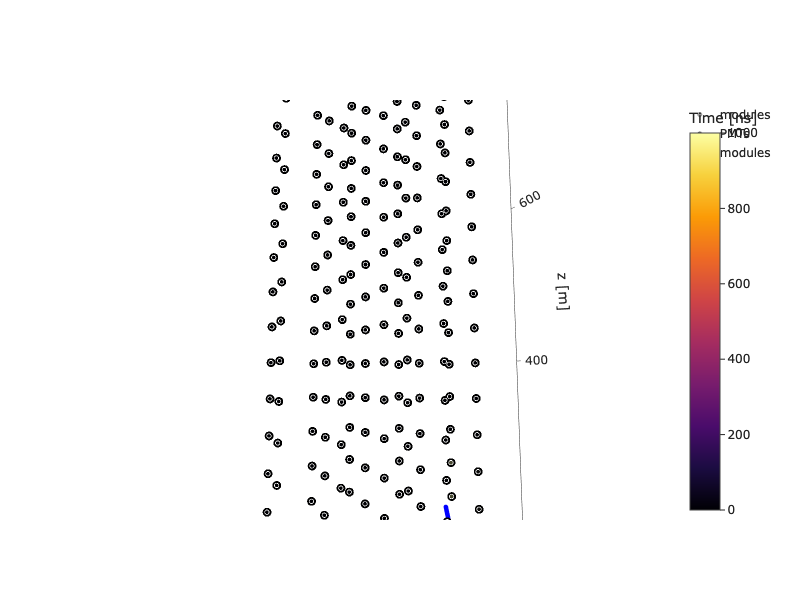

In [9]:
fig = get_detector_scatter3ds(
        detector,
        include_modules=True,
        include_pmts=True,
        hits=hits.get_by_record_ids(124),
        sources=sources.get_by_record_ids(124)
    )
fig.show()

In [9]:
configuration = MergeConfiguration.parse_obj(
    {
        'in_collections': [
            {
                'type': 'hdf5',
                'data_path': 'data/HexCascadeBenchMark.h5',
                'read_only':'False',
            },
            {
                'type': 'hdf5',
                'data_path': 'data/test/Electrical2Ks.h5',
                'read_only':'False',
            }
        ],
        'out_collection': {
                'type': 'hdf5',
                'data_path': 'data/merge6.h5',
                'read_only':'False',
        },
        'redistribution': {
            'interval': {
                'start': 0,
                'end': 1500
            },
            'mode': EventRedistributionMode.CONTAINS_EVENT
        }
    })

configuration

ValidationError: 1 validation error for MergeConfiguration
redistribution
  value is not a valid dict (type=type_error.dict)

In [9]:
configuration = MergeConfiguration.parse_obj(
    {
        'in_collections': [
            {
                'type': 'hdf5',
                'data_path': 'data/HexCascadeBenchMark.h5',
                'read_only':'False',
            },
            {
                'type': 'hdf5',
                'data_path': 'data/test/Electrical2Ks.h5',
                'read_only':'False',
            }
        ],
        'out_collection': {
                'type': 'hdf5',
                'data_path': 'data/merge9.h5',
                'read_only':'False',
        },
        'redistribution': {
            'interval': {
                'start': 0,
                'end': 1500
            },
            
        }
    })

configuration

MergeConfiguration(in_collections=[HDF5StorageConfiguration(type=<StorageTypes.HDF5: 'hdf5'>, read_only=False, batch_size=100, data_path='data/HexCascadeBenchMark.h5', complevel=3, complib='lzo', optlevel=6), HDF5StorageConfiguration(type=<StorageTypes.HDF5: 'hdf5'>, read_only=False, batch_size=100, data_path='data/test/Electrical2Ks.h5', complevel=3, complib='lzo', optlevel=6)], tmp_collection=HDF5StorageConfiguration(type=<StorageTypes.HDF5: 'hdf5'>, read_only=False, batch_size=100, data_path='/u/arego/.local/lib/python3.10/site-packages/ananke/configurations/../../_tmp_749d465e-e67c-4cb8-9ddd-ce714432892fdata.h5', complevel=3, complib='lzo', optlevel=6), out_collection=HDF5StorageConfiguration(type=<StorageTypes.HDF5: 'hdf5'>, read_only=False, batch_size=100, data_path='data/merge8.h5', complevel=3, complib='lzo', optlevel=6), content=None, redistribution=RedistributionConfiguration(interval=Interval(start=0.0, end=1500.0), mode=<EventRedistributionMode.START_TIME: 'start_time'>, se

In [3]:
9896.646079540253/60/60

2.749068355427848

In [10]:
logging.getLogger().setLevel(logging.DEBUG)

In [11]:
a=time.time()
collection=Collection.from_merge(configuration)
# Create a text file in Python
filename = "merge8.txt"

with open(filename, 'w') as file:
    file.write("it took: "+str(time.time()-a))
    
print(f"{filename} has been created.")

print("it took: ",time.time()-a)

INFO:root:Starting to merge collections with config.
INFO:root:Starting to create joined temporary collection.
DEBUG:root:Get <class 'ananke.models.detector.Detector'> with key detector at 'data/HexCascadeBenchMark.h5'
DEBUG:root:Get <class 'ananke.models.detector.Detector'> with key detector at 'data/HexCascadeBenchMark.h5'
DEBUG:root:Set <class 'ananke.models.detector.Detector'> with key detector at '/u/arego/.local/lib/python3.10/site-packages/ananke/configurations/../../_tmp_749d465e-e67c-4cb8-9ddd-ce714432892fdata.h5'
DEBUG:root:Get <class 'ananke.models.event.Records'> with key records at 'data/HexCascadeBenchMark.h5'
DEBUG:root:Set <class 'ananke.models.event.Records'> with key records at '/u/arego/.local/lib/python3.10/site-packages/ananke/configurations/../../_tmp_749d465e-e67c-4cb8-9ddd-ce714432892fdata.h5'
  0%|          | 0/10 [00:00<?, ?it/s]DEBUG:root:Get <class 'ananke.models.event.Sources'> with key sources at 'data/HexCascadeBenchMark.h5'
DEBUG:root:Get <class 'ananke.

merge8.txt has been created.
it took:  9938.09799361229


In [ ]:
a=time.time()
collection=Collection.from_merge(configuration)
print("it took: ",time.time()-a)

In [12]:
collection.open()
storage=collection.storage
detector=storage.get_detector()
hits=storage.get_hits()
sources=storage.get_sources()
records=storage.get_records()
collection.close()

DEBUG:root:Get <class 'ananke.models.detector.Detector'> with key detector at 'data/merge8.h5'
DEBUG:root:Get <class 'ananke.models.event.Hits'> with key hits at 'data/merge8.h5'
DEBUG:root:Get <class 'ananke.models.event.Sources'> with key sources at 'data/merge8.h5'
DEBUG:root:Get <class 'ananke.models.event.Records'> with key records at 'data/merge8.h5'


In [13]:
for i in records.df['record_id']:
    x=hits.get_by_record_ids(i).get_statistics()
    print(x.max-x.min)

1996.8932852185944
1989.516415579275
1999.4703512694969
1996.8516741045744
1998.9545450563987
1996.862830958042
1998.74536262299
1507.6321262275935
643.4801660775502
617.8428823039703
1996.8073573462527
1999.2768771832284
1996.8932852185944
1995.4262862010132
1989.516415579275
1999.4703512694969
1996.8516741045744
1998.9545450563987
1996.862830958042
1998.74536262299


In [6]:
for i in ['merge4.h5','merge5.h5','merge6.h5']:
    print(i)
    path='data/'+i
    config=HDF5StorageConfiguration(data_path=path,read_only=False)
    C1=Collection(config)
    C1.open()
    hits=C1.storage.get_hits()
    sources=C1.storage.get_sources()
    records=C1.storage.get_records()
    detector=C1.storage.get_detector()
    C1.close()
    for i in records.df['record_id']:
        x=hits.get_by_record_ids(i).get_statistics()
        print(i,x.max-x.min)

merge4.h5
2 1996.8932852185944
4 1989.516415579275
5 1999.4703512694966
6 1996.8516741045746
7 1998.954545056399
8 1996.862830958042
9 1998.7453626229901
10 1507.6321262275935
12 643.4801660775503
13 617.8428823039704
0 1996.8073573462527
1 1999.2768771832284
2 1996.8932852185944
3 1995.4262862010132
4 1989.516415579275
5 1999.4703512694966
6 1996.8516741045746
7 1998.954545056399
8 1996.862830958042
9 1998.7453626229901
merge5.h5
2 1996.8932852185944
4 1989.5164155792747
5 1999.4703512694969
6 1996.8516741045744
7 1998.954545056399
8 1996.862830958042
9 1998.7453626229901
10 1507.6321262275937
12 643.4801660775502
13 617.8428823039703
0 1996.8073573462527
1 1999.2768771832284
2 1996.8932852185944
3 1995.4262862010132
4 1989.5164155792747
5 1999.4703512694969
6 1996.8516741045744
7 1998.954545056399
8 1996.862830958042
9 1998.7453626229901
merge6.h5
2 1996.8932852185944
4 1989.516415579275
5 1999.4703512694969
6 1996.8516741045744
7 1998.9545450563987
8 1996.862830958042
9 1998.7453626

In [4]:
for i in records.df['record_id']:
    x=hits.get_by_record_ids(i).get_statistics()
    print(i,x.max-x.min)

2 1996.8932852185944
4 1989.516415579275
5 1999.4703512694969
6 1996.8516741045744
7 1998.9545450563987
8 1996.862830958042
9 1998.74536262299
10 1507.6321262275935
12 643.4801660775502
13 617.8428823039703
0 1996.8073573462527
1 1999.2768771832284
2 1996.8932852185944
3 1995.4262862010132
4 1989.516415579275
5 1999.4703512694969
6 1996.8516741045744
7 1998.9545450563987
8 1996.862830958042
9 1998.74536262299


/u/arego/.local/lib/python3.10/site-packages/ananke/visualisation/detector.py:81: PerformanceWarning: indexing past lexsort depth may impact performance.
  grouped_hits_dataframe.at[current_index_tuple, 'count'] = 0


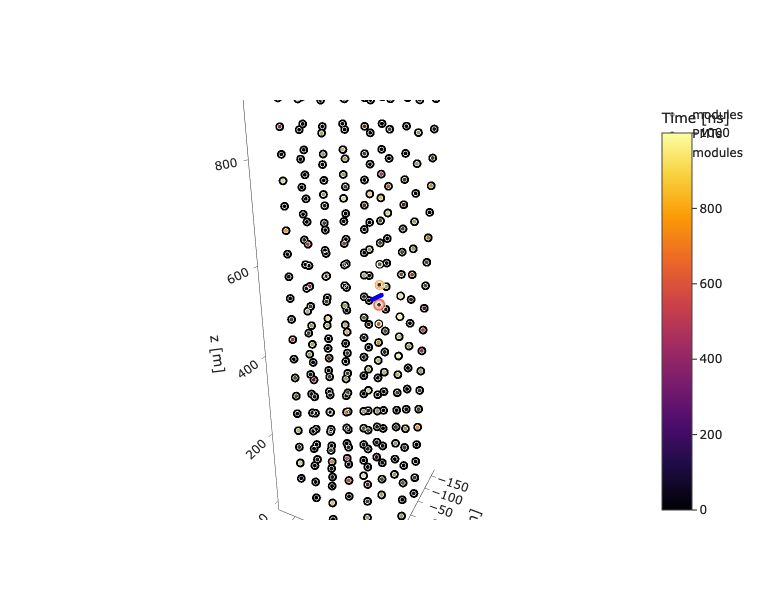

/u/arego/.local/lib/python3.10/site-packages/ananke/visualisation/detector.py:81: PerformanceWarning:

indexing past lexsort depth may impact performance.



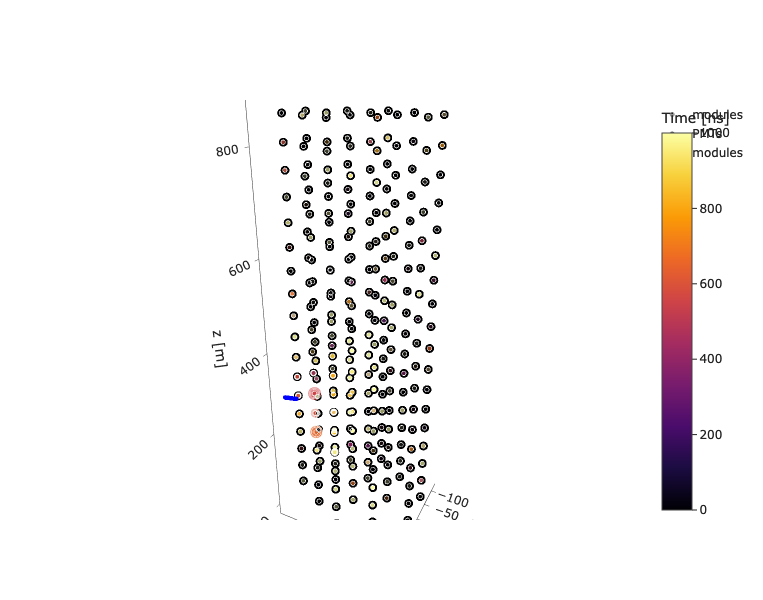

/u/arego/.local/lib/python3.10/site-packages/ananke/visualisation/detector.py:81: PerformanceWarning:

indexing past lexsort depth may impact performance.



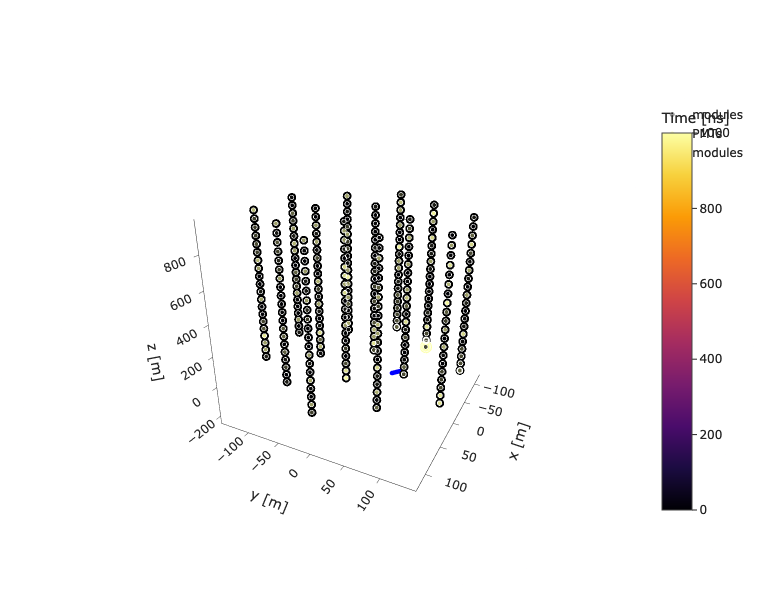

/u/arego/.local/lib/python3.10/site-packages/ananke/visualisation/detector.py:81: PerformanceWarning:

indexing past lexsort depth may impact performance.



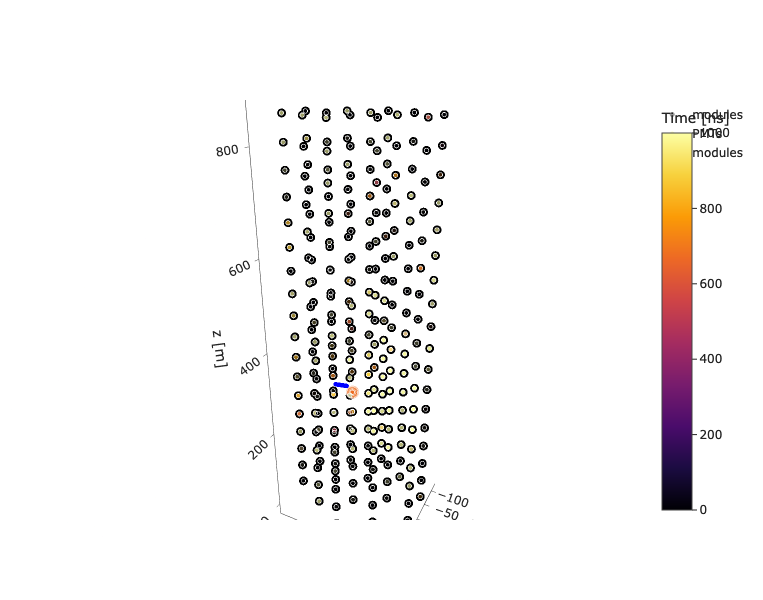

/u/arego/.local/lib/python3.10/site-packages/ananke/visualisation/detector.py:81: PerformanceWarning:

indexing past lexsort depth may impact performance.



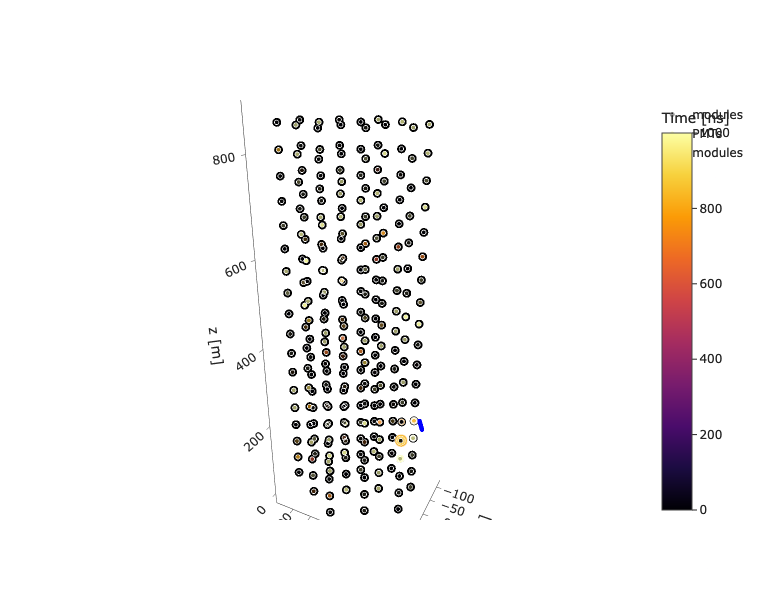

/u/arego/.local/lib/python3.10/site-packages/ananke/visualisation/detector.py:81: PerformanceWarning:

indexing past lexsort depth may impact performance.



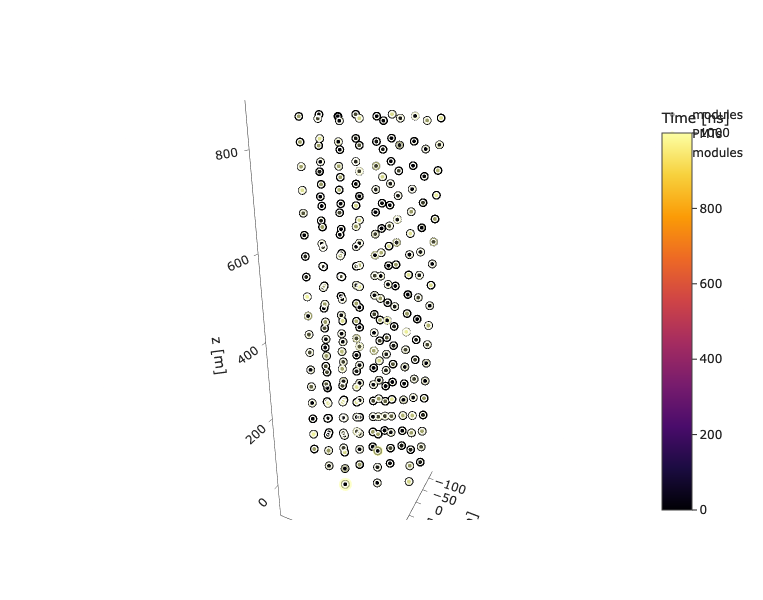

/u/arego/.local/lib/python3.10/site-packages/ananke/visualisation/detector.py:81: PerformanceWarning:

indexing past lexsort depth may impact performance.



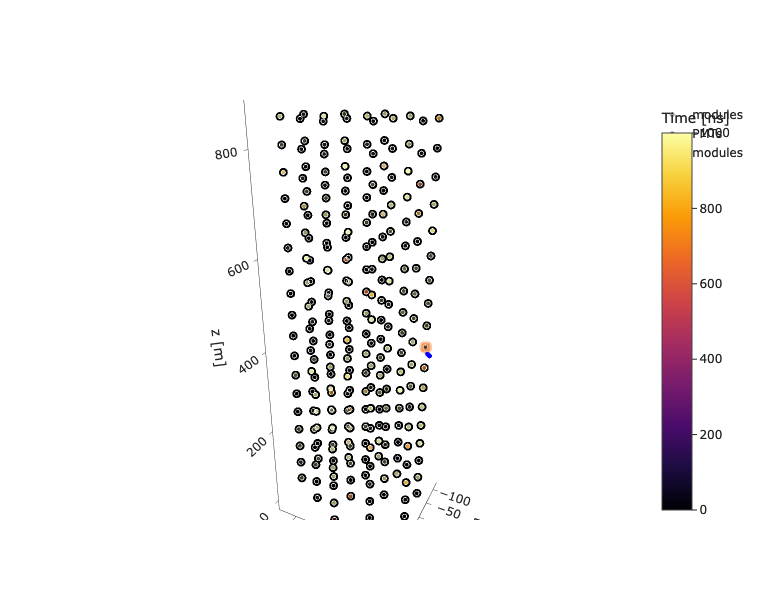

/u/arego/.local/lib/python3.10/site-packages/ananke/visualisation/detector.py:81: PerformanceWarning:

indexing past lexsort depth may impact performance.

/u/arego/.local/lib/python3.10/site-packages/ananke/visualisation/detector.py:81: PerformanceWarning:

indexing past lexsort depth may impact performance.

/u/arego/.local/lib/python3.10/site-packages/ananke/visualisation/detector.py:81: PerformanceWarning:

indexing past lexsort depth may impact performance.



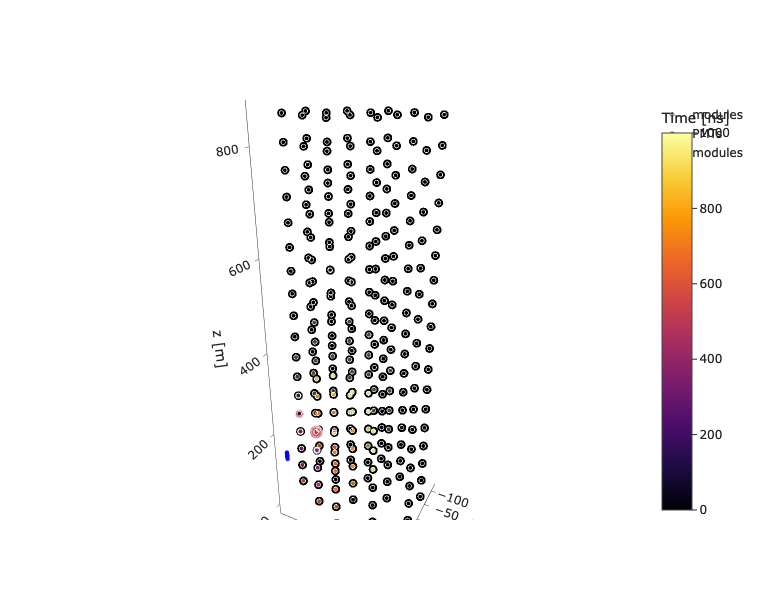

/u/arego/.local/lib/python3.10/site-packages/ananke/visualisation/detector.py:81: PerformanceWarning:

indexing past lexsort depth may impact performance.

/u/arego/.local/lib/python3.10/site-packages/ananke/visualisation/detector.py:81: PerformanceWarning:

indexing past lexsort depth may impact performance.

/u/arego/.local/lib/python3.10/site-packages/ananke/visualisation/detector.py:81: PerformanceWarning:

indexing past lexsort depth may impact performance.

/u/arego/.local/lib/python3.10/site-packages/ananke/visualisation/detector.py:81: PerformanceWarning:

indexing past lexsort depth may impact performance.

/u/arego/.local/lib/python3.10/site-packages/ananke/visualisation/detector.py:81: PerformanceWarning:

indexing past lexsort depth may impact performance.

/u/arego/.local/lib/python3.10/site-packages/ananke/visualisation/detector.py:81: PerformanceWarning:

indexing past lexsort depth may impact performance.



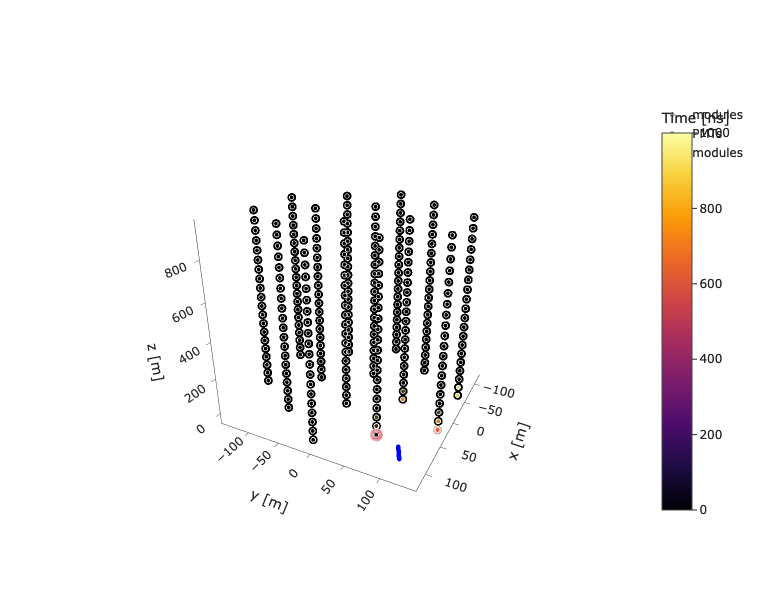

/u/arego/.local/lib/python3.10/site-packages/ananke/visualisation/detector.py:81: PerformanceWarning:

indexing past lexsort depth may impact performance.

/u/arego/.local/lib/python3.10/site-packages/ananke/visualisation/detector.py:81: PerformanceWarning:

indexing past lexsort depth may impact performance.

/u/arego/.local/lib/python3.10/site-packages/ananke/visualisation/detector.py:81: PerformanceWarning:

indexing past lexsort depth may impact performance.

/u/arego/.local/lib/python3.10/site-packages/ananke/visualisation/detector.py:81: PerformanceWarning:

indexing past lexsort depth may impact performance.

/u/arego/.local/lib/python3.10/site-packages/ananke/visualisation/detector.py:81: PerformanceWarning:

indexing past lexsort depth may impact performance.

/u/arego/.local/lib/python3.10/site-packages/ananke/visualisation/detector.py:81: PerformanceWarning:

indexing past lexsort depth may impact performance.

/u/arego/.local/lib/python3.10/site-packages/ananke/visualisatio

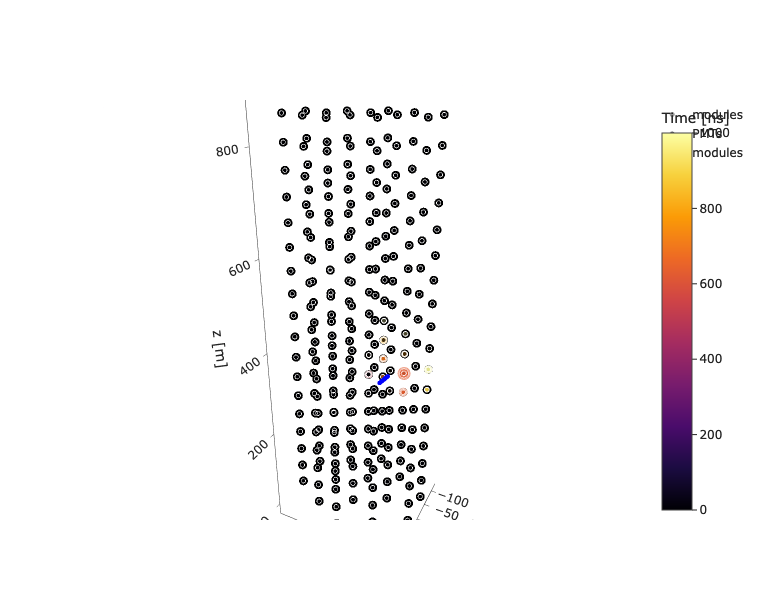

/u/arego/.local/lib/python3.10/site-packages/ananke/visualisation/detector.py:81: PerformanceWarning:

indexing past lexsort depth may impact performance.



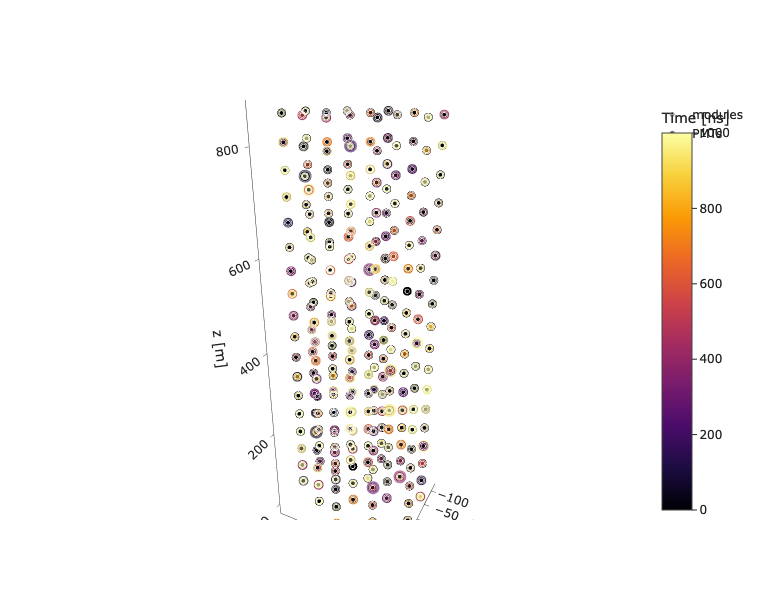

/u/arego/.local/lib/python3.10/site-packages/ananke/visualisation/detector.py:81: PerformanceWarning:

indexing past lexsort depth may impact performance.



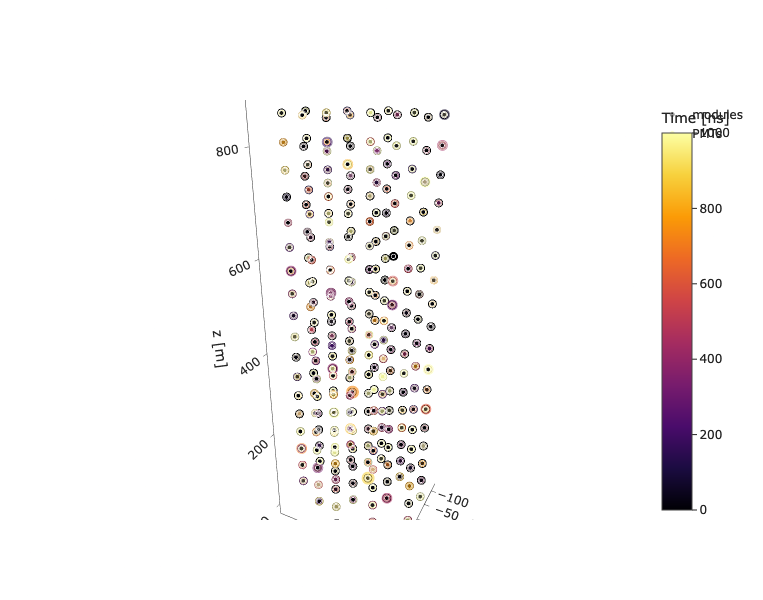

/u/arego/.local/lib/python3.10/site-packages/ananke/visualisation/detector.py:81: PerformanceWarning:

indexing past lexsort depth may impact performance.



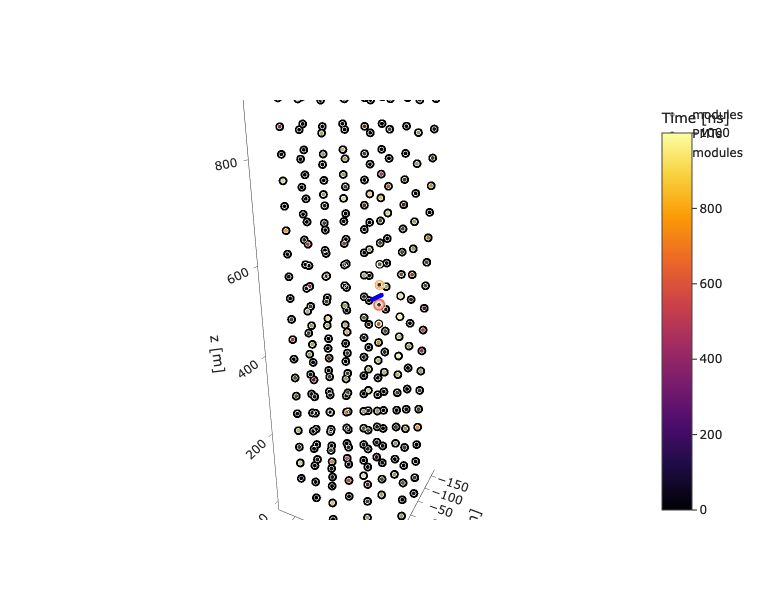

/u/arego/.local/lib/python3.10/site-packages/ananke/visualisation/detector.py:81: PerformanceWarning:

indexing past lexsort depth may impact performance.



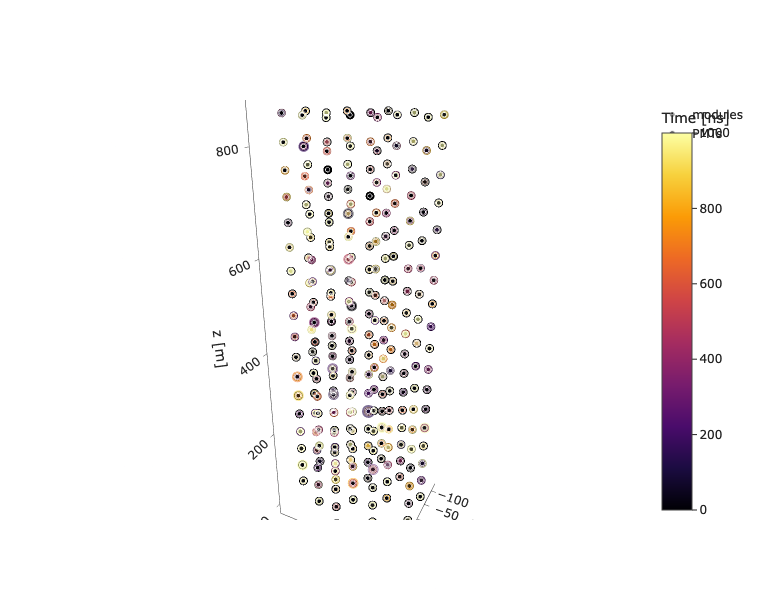

/u/arego/.local/lib/python3.10/site-packages/ananke/visualisation/detector.py:81: PerformanceWarning:

indexing past lexsort depth may impact performance.



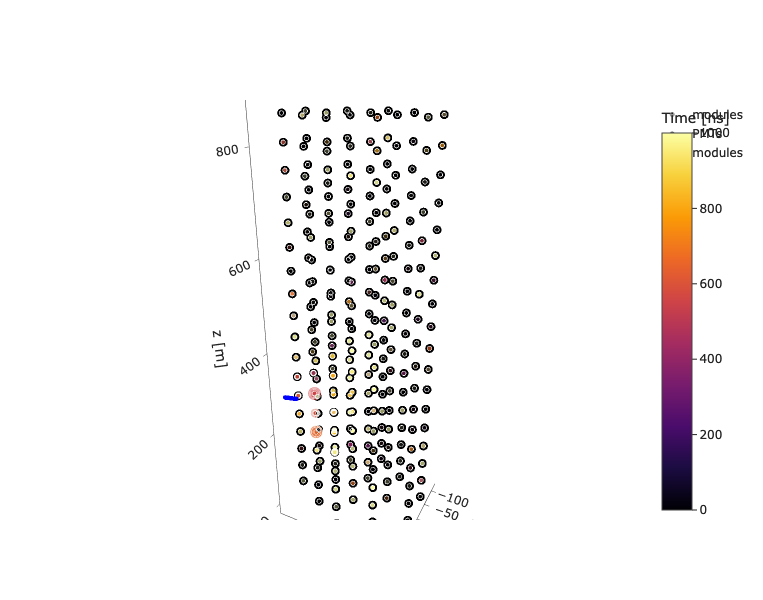

/u/arego/.local/lib/python3.10/site-packages/ananke/visualisation/detector.py:81: PerformanceWarning:

indexing past lexsort depth may impact performance.



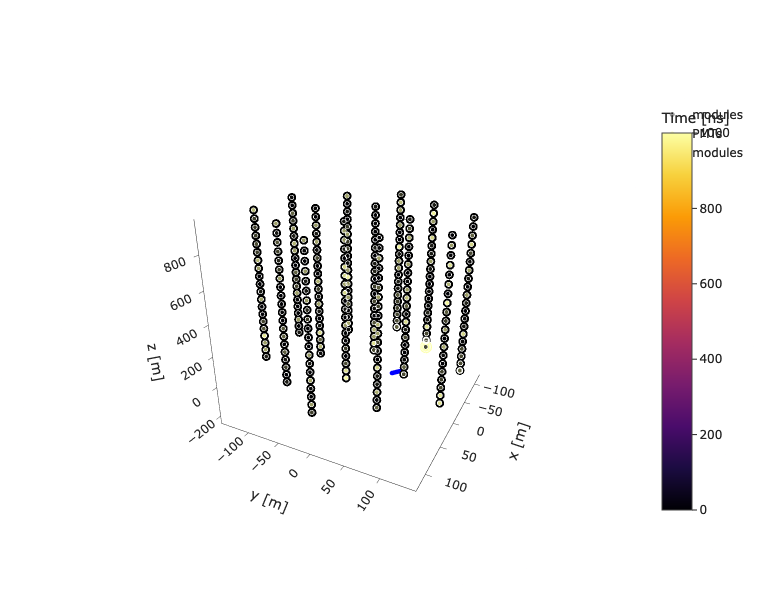

/u/arego/.local/lib/python3.10/site-packages/ananke/visualisation/detector.py:81: PerformanceWarning:

indexing past lexsort depth may impact performance.



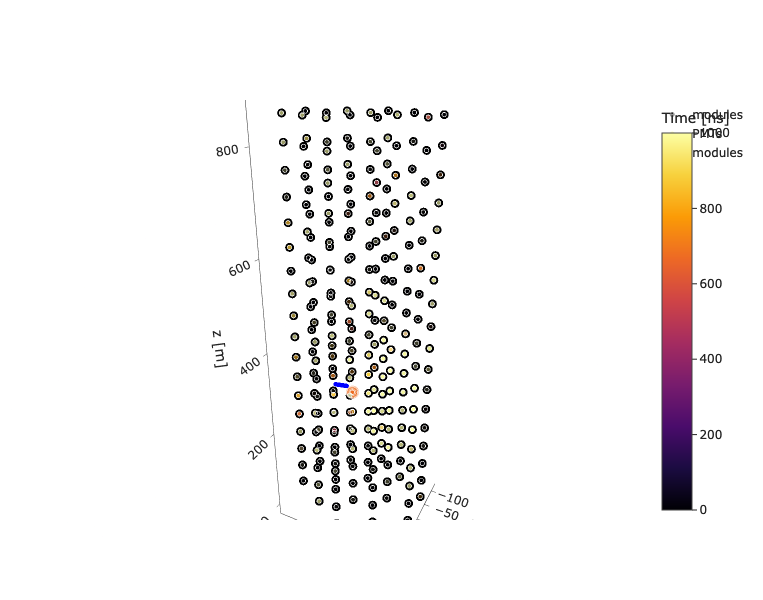

/u/arego/.local/lib/python3.10/site-packages/ananke/visualisation/detector.py:81: PerformanceWarning:

indexing past lexsort depth may impact performance.



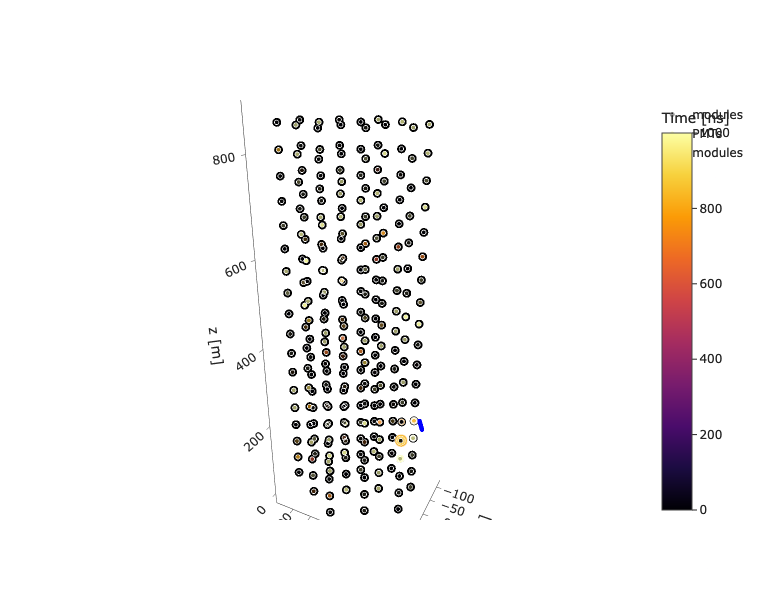

/u/arego/.local/lib/python3.10/site-packages/ananke/visualisation/detector.py:81: PerformanceWarning:

indexing past lexsort depth may impact performance.



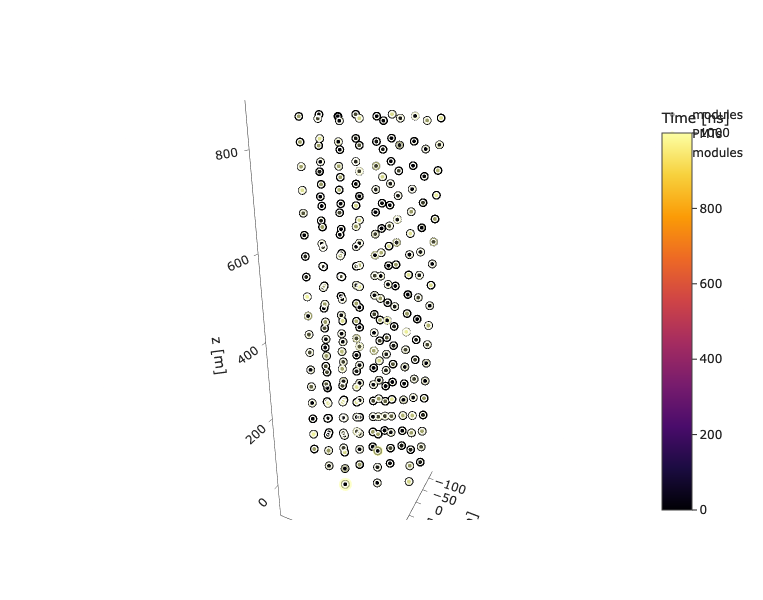

/u/arego/.local/lib/python3.10/site-packages/ananke/visualisation/detector.py:81: PerformanceWarning:

indexing past lexsort depth may impact performance.



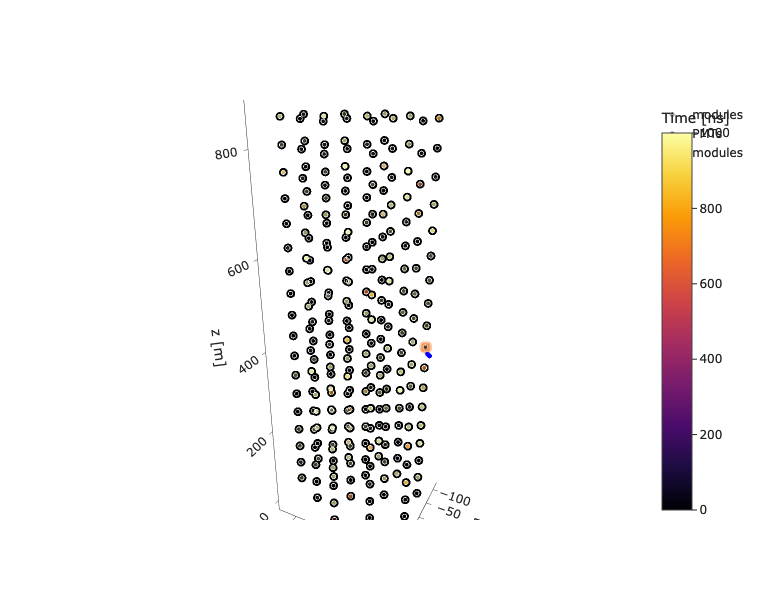

In [14]:
for i in records.df['record_id']:
    fig = get_detector_scatter3ds(
            detector,
            include_modules=True,
            include_pmts=True,
            hits=hits.get_by_record_ids(i),
            sources=sources.get_by_record_ids(i)
        )
    fig.show()

In [8]:
records.df

,location_x,location_y,location_z,orientation_x,orientation_y,orientation_z,record_id,energy,length,time,type,particle_id,duration
0,-154.788002,-33.427564,443.736516,-0.490772,0.756479,0.432298,2,32101.272279,3000.0,-943.643299,1,11,NaN
1,105.854169,-126.931308,288.042876,-0.530766,0.818127,-0.221258,4,2305.681058,3000.0,-1282.146909,1,11,NaN
2,-64.012265,20.208800,-216.406359,-0.436487,0.672804,0.597339,5,62422.788087,3000.0,864.427942,1,11,NaN
3,38.257116,-41.263073,306.950846,-0.528620,0.814819,-0.237973,6,2155.494073,3000.0,-688.076115,1,11,NaN
4,20.848573,172.442361,250.813873,-0.149179,0.229946,-0.961702,7,116.686889,3000.0,-442.701198,1,11,NaN
5,170.397953,66.320281,-68.194255,0.711295,0.414265,0.567842,8,1568.839788,3000.0,1192.177405,1,11,NaN
6,-51.148253,140.009025,378.404412,0.815855,0.475162,0.329547,9,55427.232682,3000.0,-476.323796,1,11,NaN
7,102.526177,-134.645939,115.665557,0.162473,0.094626,0.982165,10,21218.160332,3000.0,-1739.969370,1,11,NaN
8,84.605689,103.181461,-11.308332,0.560505,0.326443,-0.761097,12,34240.241604,3000.0,-185.656672,1,11,NaN
9,-54.260814,20.774832,275.013752,-0.542991,0.587868,0.599643,13,261.866222,3000.0,-159.277611,1,11,NaN


In [12]:
sources.get_by_record_ids(12).df

,location_x,location_y,location_z,orientation_x,orientation_y,orientation_z,record_id,time,number_of_photons,type
0,84.809456,103.149742,-11.304574,0.560505,0.326443,-0.761097,12,-185.319773,22,0
1,84.924599,103.280441,-11.426498,0.560505,0.326443,-0.761097,12,-184.652644,6380,0
2,84.999634,103.272285,-11.637522,0.560505,0.326443,-0.761097,12,-183.985516,146776,0
3,85.011963,103.565895,-11.765285,0.560505,0.326443,-0.761097,12,-183.318388,1181631,0
4,84.999336,103.601547,-12.022068,0.560505,0.326443,-0.761097,12,-182.651260,5354290,0
...,...,...,...,...,...,...,...,...,...,...
243,97.939957,110.862846,-29.597111,0.560505,0.326443,-0.761097,12,-105.931521,1,0
244,97.951332,111.032158,-29.778889,0.560505,0.326443,-0.761097,12,-105.264392,0,0
245,98.112831,111.058548,-29.911421,0.560505,0.326443,-0.761097,12,-104.597270,0,0
246,98.276314,111.351906,-29.927977,0.560505,0.326443,-0.761097,12,-103.930140,0,0


In [5]:
from ananke.configurations.events import EventRedistributionMode
configuration = MergeConfiguration.parse_obj(
    {
        'in_collections': [
            {
                'type': 'hdf5',
                'data_path': 'data/test/Cascade100.h5',
                'read_only': 'False'
            },
            {
                'type': 'hdf5',
                'data_path': 'data/test/Electrical100.h5',
                'read_only': 'False'
            }
        ],
        'out_collection': {
                'type': 'hdf5',
                'data_path': 'data/merge3a.h5',
                'read_only': 'False'
        },
            
        })

configuration

MergeConfiguration(in_collections=[HDF5StorageConfiguration(type=<StorageTypes.HDF5: 'hdf5'>, read_only=False, batch_size=100, data_path='data/test/Cascade100.h5', complevel=3, complib='lzo', optlevel=6), HDF5StorageConfiguration(type=<StorageTypes.HDF5: 'hdf5'>, read_only=False, batch_size=100, data_path='data/test/Electrical100.h5', complevel=3, complib='lzo', optlevel=6)], tmp_collection=HDF5StorageConfiguration(type=<StorageTypes.HDF5: 'hdf5'>, read_only=False, batch_size=100, data_path='/u/arego/.local/lib/python3.10/site-packages/ananke/configurations/../../_tmp_d95945a9-a234-44a2-adb2-702f10e2f33cdata.h5', complevel=3, complib='lzo', optlevel=6), out_collection=HDF5StorageConfiguration(type=<StorageTypes.HDF5: 'hdf5'>, read_only=False, batch_size=100, data_path='data/merge3a.h5', complevel=3, complib='lzo', optlevel=6), content=None, redistribution=None, seed=32118)

In [6]:
a=time.time()
collection=Collection.from_merge(configuration)
print("it took: ",time.time()-a)

INFO:root:Starting to merge collections with config.
INFO:root:Starting to create joined temporary collection.
100%|██████████| 100/100 [02:20<00:00,  1.40s/it]
INFO:Collection:Starting to append collection.
100%|██████████| 100/100 [00:00<00:00, 373.41it/s]
INFO:Collection:Finished to append collection.
INFO:root:Finished creating joined temporary collection.
100%|██████████| 200/200 [04:56<00:00,  1.48s/it]
INFO:root:Finished to merge collections with config.


it took:  438.13267993927
